# 01-perf-explore

Arvid Lundervold, MMIV, UiB  2020-05-05
#### UNDER CONSTRUCTION

## Learning objectives

- Define perfusion as a physiological process
- Describe the principles of perfusion MRI (DSC-MR with first pass bolustracking)
- Provide an examples with real data

## Example - healthy volunteer, M, 51 yr. 

- Recording date: 20030919
- Siemens 1.5 T MAGNETOM VISION plus

- Sequence: ep2d_fidp_54b1470
- Receiver coil: CP head
- TR: 1442.0 ms
- TE: 60.73 ms
- EchoNumbers: 4
- FlipAngle: 90
- PhaseEncodingDirection: COL
- Slice ordering: Interleave
- NumberofAverages: 50 (frames)
- Number of slices: 11
- Acquisition matrix: 128 x 128
- Slice thickness: 5 mm 
- Receiver coil: CP head
- FOV: 230 x 230 mm2
- PixelSpacing: 1.797 x 1.797 mm2
- TA: 1 min 12 s


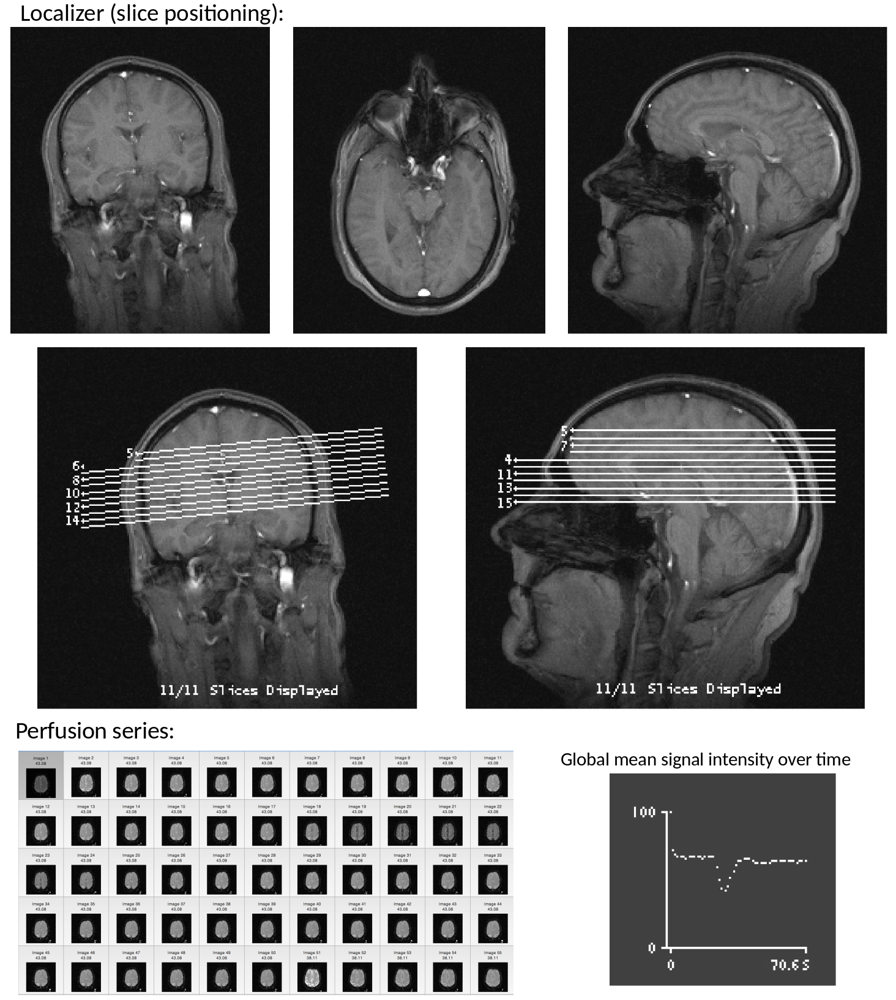

In [1]:
from IPython.display import Image
Image('./assets/perfusion_20030919.png', width=700)

## Setting up our Python environment

In [2]:
%matplotlib inline
import os
import pathlib
import numpy as np
import pandas as pd
import nibabel as nib
import nilearn
import imageio
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
import skimage

In [3]:
fn = './data/Arvid_Perf_20030919.nii.gz'

**Make a series of .png files using Freesurfer; then make animated GIF  / or, using `peek` in Linux**

In [4]:
# from pathlib import Path
# image_path = Path('~/tmp')
# images = np.sort(list(image_path.glob('*.png')))
# image_list = []
# for file_name in images:
#     image_list.append(imageio.imread(file_name))
# imageio.mimwrite('~/tmp/animated_from_images.gif', image_list, duration=0.5)

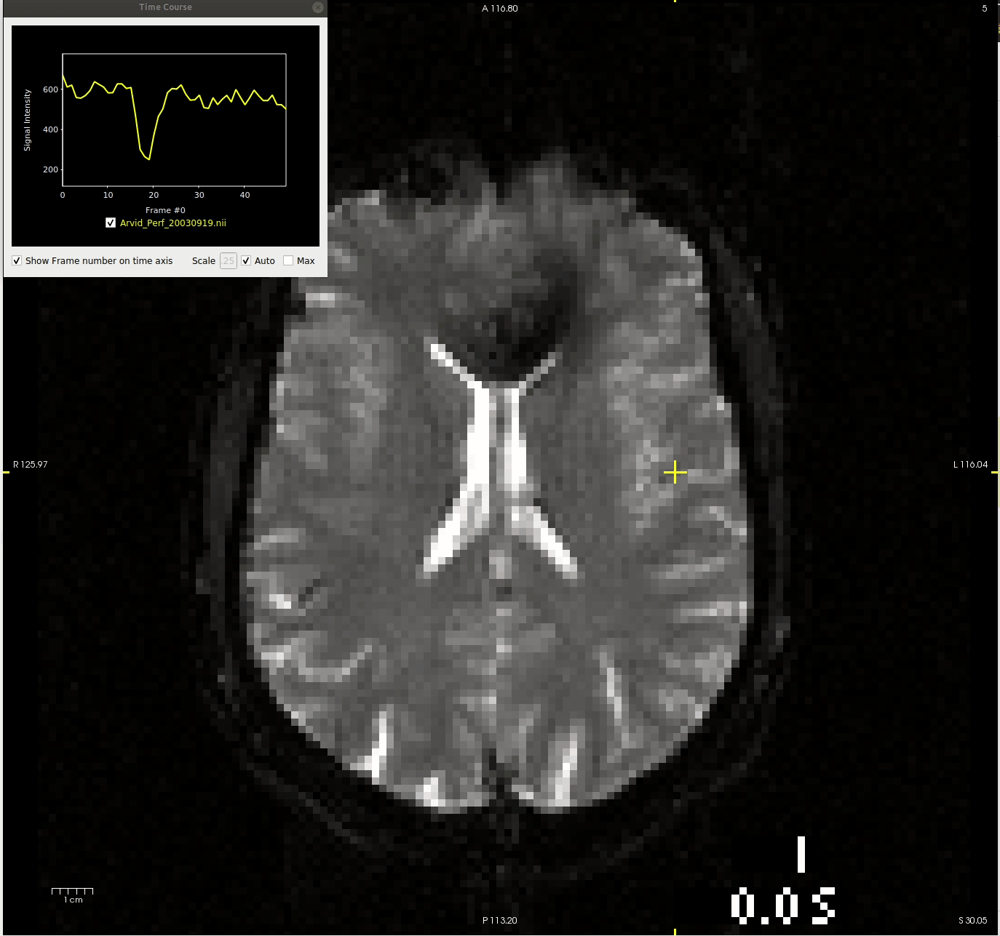

In [5]:
from IPython.display import Image
Image('./assets/perfusion_20030919_peek.gif', width=500)

## Read the 4D DSC-MRI data

In [6]:
# Using nibabel to read the brain DSC-MRI data
img = nib.load(fn)

In [7]:
aff = img.affine

**Print properties of the DSC-MRI NIFTI image**

In [8]:
print('**DSC-MRI data info:**')
print(img.get_filename())
print('shape of image = ', img.header.get_data_shape())
print('units = ', img.header.get_xyzt_units())
print('voxel size = ', img.header.get_zooms())
print('dtype = %s' % img.header.get_data_dtype())
data = img.get_fdata()
print('min = %.1f' % data.min())
print('max = %.1f' % data.max())
print('number of timepoints =', img.shape[-1])
# Collaps the singular (z-)dimension
img_data = np.uint16(data.squeeze())
print('shape of 4D img_data = ',img_data.shape)
print('dtype of 4D img_data = ',img_data.dtype)
print('img affine:', img.affine)
print(img.header)

**DSC-MRI data info:**
./data/Arvid_Perf_20030919.nii.gz
shape of image =  (128, 128, 11, 50)
units =  ('mm', 'unknown')
voxel size =  (1.796875, 1.796875, 5.0000005, 0.0)
dtype = int16
min = 0.0
max = 3257.0
number of timepoints = 50
shape of 4D img_data =  (128, 128, 11, 50)
dtype of 4D img_data =  uint16
img affine: [[  -1.78703153   -0.            0.52264202  114.93518066]
 [  -0.            1.796875     -0.         -113.203125  ]
 [   0.18782465   -0.            4.97261      -6.64364672]
 [   0.            0.            0.            1.        ]]
<class 'nibabel.nifti1.Nifti1Header'> object, endian='<'
sizeof_hdr      : 348
data_type       : b''
db_name         : b'Lundervold, Arvid'
extents         : 16384
session_error   : 0
regular         : b'r'
dim_info        : 57
dim             : [  4 128 128  11  50   1   1   1]
intent_p1       : 0.0
intent_p2       : 0.0
intent_p3       : 0.0
intent_code     : none
datatype        : int16
bitpix          : 16
slice_start     : 0
pixdim  

**Display selected slice and four different timeframes**

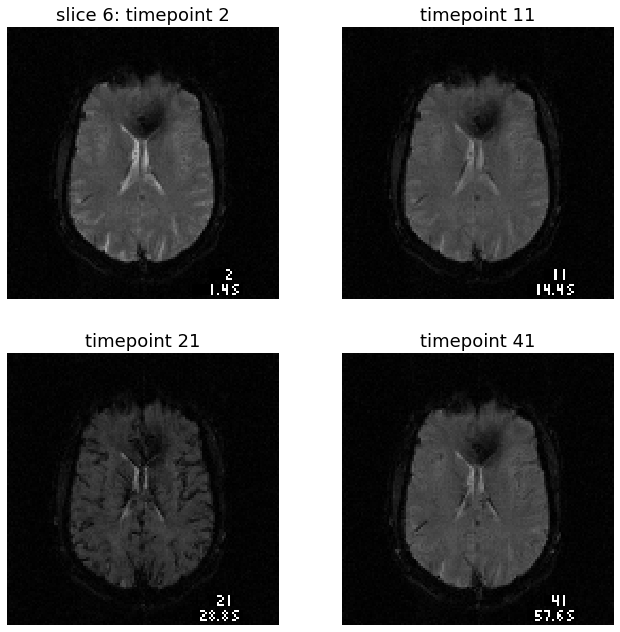

In [9]:
# Arrays starts at 0 (therefors add 1 in the figure)
s = 5
t = [1, 10, 20, 40]

fig = plt.figure('Showing the DSC-MRI image', figsize = [11,11])
plt.tight_layout
plt.subplot(2, 2, 1).set_axis_off(), plt.title('slice %d: timepoint %d' % (s+1, t[0]+1), fontsize=18)
#plt.imshow(np.fliplr(np.rot90(data[:, :, s, t[0]].squeeze(), k=3)), cmap='gray', origin='lower')  
plt.imshow(data[:, :, s, t[0]].T, cmap='gray', origin='lower')  
plt.subplot(2, 2, 2).set_axis_off(), plt.title('timepoint %d' % (t[1]+1), fontsize=18)
plt.imshow(np.fliplr(np.rot90(data[:, :, s, t[1]].squeeze(), k=3)), cmap='gray', origin='lower')
plt.subplot(2, 2, 3).set_axis_off(), plt.title('timepoint %d' % (t[2]+1), fontsize=18)
plt.imshow(np.fliplr(np.rot90(data[:, :, s, t[2]].squeeze(), k=3)), cmap='gray', origin='lower')
plt.subplot(2, 2, 4).set_axis_off(), plt.title('timepoint %d' % (t[3]+1), fontsize=18)
plt.imshow(np.fliplr(np.rot90(data[:, :, s, t[3]].squeeze(), k=3)), cmap='gray', origin='lower')
plt.show()

#fig.savefig('%s/prj/BMED360-2020/results/brain_dsc_mri_slice%d.png' % (home, s),
#            transparent=False, dpi=300, bbox_inches="tight")

In [10]:
# Number of voxels in the 4D image
print(data.flatten().min())
print(data.flatten().max())
data.flatten().size

0.0
3257.0


9011200

In [11]:
# Generally, we could use an ROI mask for the brain. We let this ROI be the whole first volume + 1, i.e.
data_msk = data[:,:,:,0]+1
print(data_msk.flatten().min())
print(data_msk.flatten().max())
data_msk.shape

1.0
3258.0


(128, 128, 11)

**Find all pixel locations in the ROI for extracting a dataset X and corresponding pixel locations to a Pandas data frame (dfR)**

In [12]:
# Find voxel locations (ind_roi) corresponding to brain ROI (value >=1 inside ROI, 0 else) 
ind_roi = np.where(data_msk > 0) 
X = np.asarray(img_data[ind_roi[0][:],ind_roi[1][:],ind_roi[2][:],:]) # The DCE-MRI voxel time courses within ROI
print(X.shape)

(180224, 50)


In [13]:
# Find corners in the ROI (in the general case)
min_row = min(ind_roi[0])
max_row = max(ind_roi[0])

min_col = min(ind_roi[1])
max_col = max(ind_roi[1])

min_slice = min(ind_roi[2])
max_slice = max(ind_roi[2])

min_corner = [min_row, min_col, min_slice]
max_corner = [max_row, max_col, max_slice]

print('min_corner:', min_corner)
print('max_corner:', max_corner)

min_corner: [0, 0, 0]
max_corner: [127, 127, 10]


In [14]:
dfR = pd.DataFrame(X)
dfR.head(3)

,0,1,2,3,4,5,6,7,8,9,...,40,41,42,43,44,45,46,47,48,49
0,22,47,33,44,20,44,48,9,7,32,...,44,25,13,49,37,34,53,35,32,11
1,10,31,18,44,68,8,13,23,5,36,...,58,28,58,15,27,11,23,8,52,27
2,41,10,22,26,49,5,15,41,14,72,...,24,69,13,45,34,20,22,53,19,35


In [15]:
dfR.tail(3)

,0,1,2,3,4,5,6,7,8,9,...,40,41,42,43,44,45,46,47,48,49
180221,14,25,26,15,14,36,53,19,15,37,...,49,54,16,20,28,17,44,23,58,5
180222,18,31,29,75,73,30,53,25,40,32,...,67,22,67,50,36,26,49,48,44,67
180223,82,37,18,19,19,47,46,20,15,44,...,27,32,33,59,34,21,37,23,8,78


**Insert voxel locations in the ROI**

In [16]:
dfR.insert(loc = len(dfR.columns),
           column = 'row',
           value = ind_roi[0])  # Row of voxel location
dfR.insert(loc = len(dfR.columns),
           column = 'col',
           value = ind_roi[1])  # Col of voxel location
dfR.insert(loc = len(dfR.columns),
           column = 'slice',
           value = ind_roi[2])  # Slice of voxel location

In [17]:
dfR.head()

,0,1,2,3,4,5,6,7,8,9,...,43,44,45,46,47,48,49,row,col,slice
0,22,47,33,44,20,44,48,9,7,32,...,49,37,34,53,35,32,11,0,0,0
1,10,31,18,44,68,8,13,23,5,36,...,15,27,11,23,8,52,27,0,0,1
2,41,10,22,26,49,5,15,41,14,72,...,45,34,20,22,53,19,35,0,0,2
3,56,36,43,13,65,40,29,72,46,52,...,56,38,29,23,51,24,41,0,0,3
4,13,72,30,49,44,8,53,27,33,49,...,16,43,66,45,8,41,41,0,0,4


## Unsupervised classification of  the 4D DSC-MRI data using K-means

Let X be the n x p data matrix, n = numper of samples (voxel time courses), p = feature vector dimension (time points)

In [18]:
X.shape

(180224, 50)

In [19]:
K = 2  # Number of clusters
kmeans_model = KMeans(n_clusters=K, random_state=42)
print(kmeans_model)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=2, n_init=10, n_jobs=None, precompute_distances='auto',
       random_state=42, tol=0.0001, verbose=0)


**Fit the K-means model to the data**

In [20]:
%%time
kmeans_fit = kmeans_model.fit(X)

CPU times: user 18.5 s, sys: 311 ms, total: 18.8 s
Wall time: 1.25 s


In [21]:
print(kmeans_fit.labels_)
print('First centroid i p-dimensional feature vector space:\n', kmeans_fit.cluster_centers_[0,:])

[0 0 0 ... 0 0 0]
First centroid i p-dimensional feature vector space:
 [59.99042275 48.58273992 47.07943483 46.6505844  46.6187654  46.67673968
 46.62166486 46.80452647 46.77357881 46.70769485 46.8919461  46.66150622
 46.56822757 46.66623851 46.6531834  46.65269515 45.8037002  44.07923202
 42.09812361 40.80167207 40.63102428 40.79875007 41.94516556 42.71555195
 43.39353855 44.04307884 44.83243946 45.21603269 45.37048555 45.70810048
 46.0335091  45.47171895 45.69377591 45.68143441 45.74034012 45.8967535
 46.27434499 46.31077609 46.35151133 46.57819542 46.72892254 46.88900907
 46.74903852 46.78018899 46.69010276 46.70107716 46.78625834 46.85773842
 46.90479088 46.87466949]


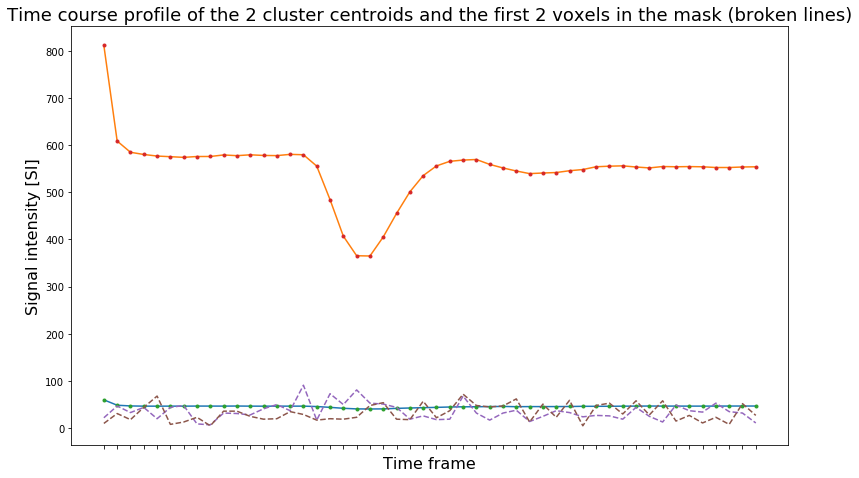

In [22]:
# Plot the cluster centroids as line plots

nv = 2

fig, ax = plt.subplots(1,1)

fig.set_size_inches(12, 7)

plt.plot(kmeans_fit.cluster_centers_.T)
plt.plot(kmeans_fit.cluster_centers_.T, '.')
plt.plot(X[:nv, :].T, '--')
plt.xlabel('Time frame', fontsize=16)
ax.set_xticks([x for x in range(X.shape[1])])
ax.set_xticklabels([], rotation='vertical', fontsize=18)
plt.ylabel('Signal intensity [SI]', fontsize=16)
#plt.xlim(0, 3)
plt.title('Time course profile of the %d cluster centroids and the first %d voxels in the mask (broken lines)' % (K, nv), fontsize=18)

plt.subplots_adjust(bottom=.12, top=.95, right=.95, left=.12)

plt.show()


**Make a k-means segmented image (segmentation restricted to the ROI)**

In [23]:
kmeans_segm2 = 0 * data_msk.copy()
print('Size of segmented image:', kmeans_segm2.shape)
print('min:', kmeans_fit.labels_.min())
print('max:', kmeans_fit.labels_.max())
print('Number of clustered samples within ROI:', len(ind_roi[0]))

Size of segmented image: (128, 128, 11)
min: 0
max: 1
Number of clustered samples within ROI: 180224


**Assign the cluster belonging to each voxel within the ROI**

In [24]:
for v in range(len(ind_roi[0])):
    kmeans_segm2[ind_roi[0][v], ind_roi[1][v], ind_roi[2][v]] = kmeans_fit.labels_[v]

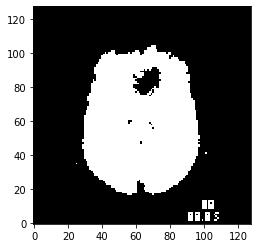

In [25]:
plt.imshow(kmeans_segm2[:, :, s].T, cmap='gray', origin='lower')
plt.show()

**The following function gives the largest connected segmentation which is not backgroud. The shape of input and output is the same which could be 2D or 3D images.**<br>
https://stackoverflow.com/questions/47540926/get-the-largest-connected-component-of-segmentation-image


In [26]:
import numpy as np
from skimage.measure import label

def getLargestCC(segmentation):
    labels = label(segmentation)
    unique, counts = np.unique(labels, return_counts=True)
    list_seg=list(zip(unique, counts))[1:] # the 0 label is by default background so take the rest
    largest=max(list_seg, key=lambda x:x[1])[0]
    labels_max=(labels == largest).astype(int)
    return labels_max

In [27]:
kmeans_segm2_max = getLargestCC(kmeans_segm2)

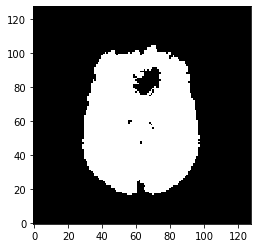

In [28]:
plt.imshow(kmeans_segm2_max[:, :, s].T, cmap='gray', origin='lower')
plt.show()

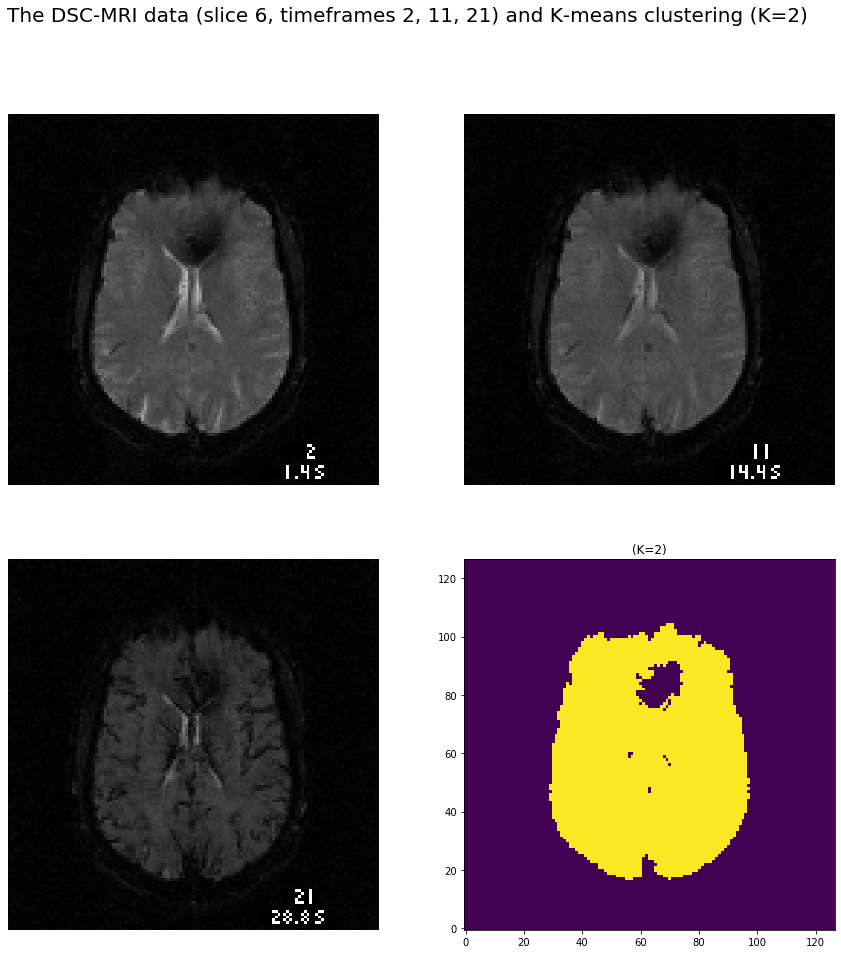

In [29]:
fig, axes = plt.subplots(2,2, figsize=(15,15))
ax = axes.ravel()
ax[0].imshow(img_data[:, :, s, t[0]].T, cmap='gray', origin='lower')
ax[0].set(xlabel="")
ax[0].axis('off')
ax[1].imshow(img_data[:, :, s, t[1]].T, cmap='gray', origin='lower')
ax[1].set(xlabel="")
ax[1].axis('off')
ax[2].imshow(img_data[:, :, s, t[2]].T, cmap='gray', origin='lower')
ax[2].set(xlabel="")
ax[2].axis('off')
ax[3].imshow(kmeans_segm2_max[min_row:max_row, min_col:max_col, s].T, cmap='viridis', origin='lower')  #'viridis', 'gray'
ax[3].set_title('(K=%d)' % (K))
plt.suptitle('The DSC-MRI data (slice %d, timeframes %d, %d, %d) and K-means clustering (K=%d)' % (s+1,t[0]+1,t[1]+1,t[2]+1, K), fontsize=20) 
#plt.tight_layout
plt.show()

In [30]:
print(kmeans_segm2_max.flatten().min())
print(kmeans_segm2_max.flatten().max())
kmeans_segm2_max.shape

0
1


(128, 128, 11)

In [31]:
fn_roi = './data/Arvid_Perf_20030919_roi.nii.gz'
img_roi = nib.Nifti1Image(kmeans_segm2_max, aff)
nib.save(img_roi, fn_roi)

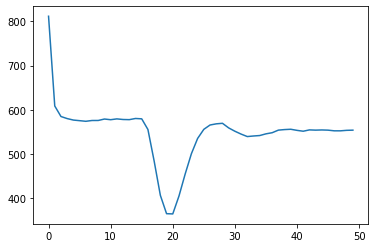

In [32]:
aif = kmeans_fit.cluster_centers_[1,:].T
plt.plot(aif)
plt.show()

In [33]:
fn_aif = './data/Arvid_Perf_20030919_aif.dat'
aif_df = pd.DataFrame({'aif': aif}) 
aif_df.to_csv(fn_aif, header=False, index=False)

## Make a K-means segmenation function working on 4D data with a 3D  ROI mask

In [34]:
def kmeans_4D_segmentation(K, data, mask):
    '''
    Arvid Lundervold, 20200505
    Input: ...
    K - number of clusters
    data - 3D+time numpy array
    mask - 3D ROI mask (>0 within the ROI, =0 outside)
    Output ...
    df -
    dg -
    kmeans_segm - K-means segmented 3D image (numpy array)
    data_smooth - K-means smoothed 3D+time input data (within the ROI mask), i.e. K unique timecourses
    '''
    
    # Find voxel locations (ind_roi) corresponding to brain ROI (value >=1 inside ROI, 0 else) 
    ind_roi = np.where(mask > 0) 
    X = np.asarray(data[ind_roi[0][:],ind_roi[1][:],ind_roi[2][:],:])
    df = pd.DataFrame(X)
    
    # Insert voxel location in the dataframe
    df.insert(loc = len(df.columns),
           column = 'row',
           value = ind_roi[0])  # Row of voxel location
    df.insert(loc = len(df.columns),
           column = 'col',
           value = ind_roi[1])  # Col of voxel location
    df.insert(loc = len(df.columns),
           column = 'slice',
           value = ind_roi[2])  # Slice of voxel location
    
    # Define the K-means model
    K = K  # Number of clusters
    kmeans_model = KMeans(n_clusters=K, random_state=42)
    
    # Fit the K-means model to the data
    kmeans_fit = kmeans_model.fit(X)
    
    # Make a K-means segmented image (segmentation restricted to the ROI)
    kmeans_segm = 0 * mask.copy()
    
    # Assign the cluster belonging to each voxel within the ROI
    for v in range(len(ind_roi[0])):
        kmeans_segm[ind_roi[0][v], ind_roi[1][v], ind_roi[2][v]] = kmeans_fit.labels_[v]
    
    # Make a dataframe of cluster centroides
    dg = pd.DataFrame(kmeans_fit.cluster_centers_)
    
    # Make a K-means smoothed (within the ROI) 4D dataset
    data_smooth = data.copy()      
    for v in range(len(ind_roi[0])):
        data_smooth[ind_roi[0][v], ind_roi[1][v], ind_roi[2][v]] = kmeans_fit.cluster_centers_[kmeans_fit.labels_[v],:]
    
    return df, dg, kmeans_segm, data_smooth

In [35]:
%%time
K = 64
dfK, dgK, kmeans_segm_K, data_smooth_K = kmeans_4D_segmentation(K, data, kmeans_segm2_max)

CPU times: user 8min 28s, sys: 7.22 s, total: 8min 35s
Wall time: 32.4 s


In [36]:
dfK

,0,1,2,3,4,5,6,7,8,9,...,43,44,45,46,47,48,49,row,col,slice
0,626.0,427.0,383.0,427.0,377.0,415.0,399.0,375.0,383.0,410.0,...,292.0,320.0,274.0,303.0,319.0,272.0,267.0,27,48,2
1,515.0,362.0,349.0,364.0,386.0,382.0,330.0,372.0,346.0,399.0,...,294.0,262.0,245.0,256.0,292.0,225.0,274.0,27,49,2
2,587.0,435.0,363.0,356.0,378.0,394.0,365.0,342.0,375.0,355.0,...,270.0,260.0,242.0,285.0,243.0,263.0,245.0,27,50,2
3,650.0,390.0,367.0,417.0,391.0,362.0,363.0,388.0,430.0,351.0,...,247.0,284.0,286.0,235.0,215.0,253.0,252.0,28,42,2
4,704.0,521.0,473.0,460.0,424.0,462.0,484.0,459.0,465.0,445.0,...,365.0,331.0,343.0,327.0,325.0,298.0,352.0,28,43,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45213,891.0,485.0,396.0,415.0,371.0,422.0,419.0,383.0,418.0,401.0,...,461.0,484.0,462.0,445.0,437.0,448.0,459.0,98,55,0
45214,784.0,438.0,411.0,372.0,387.0,370.0,362.0,438.0,403.0,338.0,...,432.0,412.0,387.0,419.0,418.0,422.0,398.0,98,55,1
45215,802.0,472.0,425.0,409.0,433.0,436.0,418.0,422.0,449.0,413.0,...,469.0,431.0,476.0,483.0,501.0,472.0,469.0,98,56,0
45216,504.0,387.0,349.0,326.0,293.0,330.0,296.0,354.0,348.0,323.0,...,379.0,416.0,414.0,388.0,419.0,411.0,382.0,98,56,1


In [37]:
dgK

,0,1,2,3,4,5,6,7,8,9,...,40,41,42,43,44,45,46,47,48,49
0,1034.257042,735.690141,698.056338,687.792254,684.147887,686.500000,680.897887,680.911972,680.334507,678.204225,...,648.369718,647.021127,652.073944,648.890845,645.088028,644.278169,645.542254,644.626761,648.887324,650.820423
1,648.647586,557.807241,551.769310,551.401724,550.685517,550.580690,550.278621,549.663793,551.937931,551.981379,...,544.152414,541.422414,540.986552,541.142414,541.385517,542.223448,541.185862,542.522759,542.411034,542.376897
2,872.183230,573.490683,536.086957,524.729814,519.872671,520.624224,519.894410,516.369565,517.428571,516.118012,...,437.422360,438.263975,437.956522,432.981366,433.310559,433.096273,433.335404,433.854037,434.732919,437.142857
3,850.014235,627.838968,603.088078,597.121886,594.258007,592.749110,591.100534,591.659253,592.263345,591.337189,...,551.653915,549.386121,550.538256,550.627224,549.985765,550.066726,548.767794,550.629893,550.154804,550.988434
4,2013.156522,1102.173913,926.878261,883.443478,861.286957,859.095652,853.652174,848.382609,857.513043,852.295652,...,816.408696,809.782609,806.634783,807.460870,811.626087,809.391304,802.982609,809.504348,808.886957,805.426087
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59,991.363305,712.562576,672.987849,663.810450,659.652491,658.007290,654.935601,656.605103,658.244228,656.475091,...,625.029162,619.876063,623.315917,624.442284,621.054678,621.882139,621.021871,622.074119,622.808019,624.340219
60,760.850711,621.661927,614.093207,610.005529,608.610585,609.579779,609.812006,608.582938,610.124803,610.513428,...,594.064771,591.939179,592.716430,593.490521,591.928910,595.248815,593.452607,591.699842,594.528436,593.589258
61,737.608676,596.695431,585.119059,583.120443,581.940932,582.602215,582.609137,581.290263,582.186894,582.372404,...,565.064605,563.472081,565.776188,564.248731,563.604061,564.504845,563.595754,564.494232,564.912783,565.381634
62,859.247940,648.626217,623.322097,618.590262,618.057678,616.648689,614.137079,615.345318,616.364045,615.572285,...,589.913858,588.615730,588.833708,588.256929,588.881648,589.026966,587.408989,589.727341,589.401498,588.369288


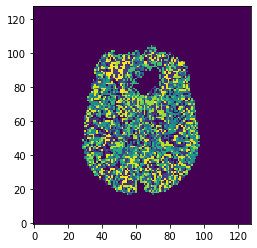

In [38]:
plt.imshow(kmeans_segm_K[:, :, s].T, cmap='viridis', origin='lower')
plt.show()

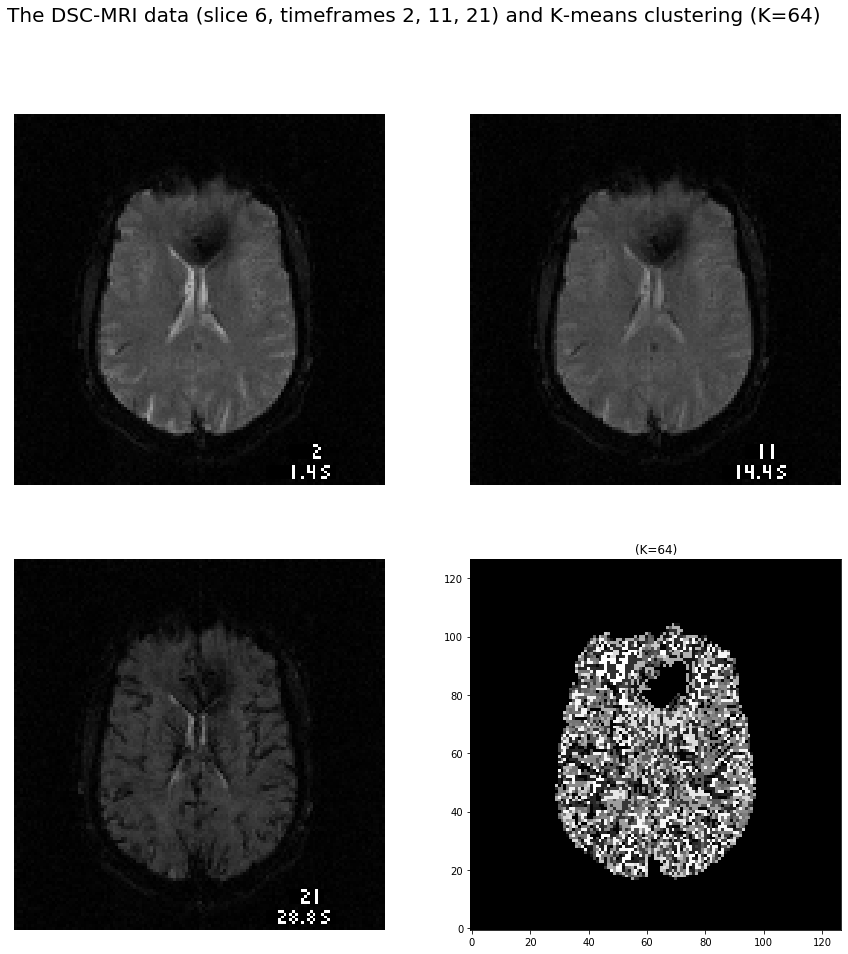

In [39]:
fig, axes = plt.subplots(2,2, figsize=(15,15))
ax = axes.ravel()
ax[0].imshow(img_data[:, :, s, t[0]].T, cmap='gray', origin='lower')
ax[0].set(xlabel="")
ax[0].axis('off')
ax[1].imshow(img_data[:, :, s, t[1]].T, cmap='gray', origin='lower')
ax[1].set(xlabel="")
ax[1].axis('off')
ax[2].imshow(img_data[:, :, s, t[2]].T, cmap='gray', origin='lower')
ax[2].set(xlabel="")
ax[2].axis('off')
ax[3].imshow(kmeans_segm_K[min_row:max_row, min_col:max_col, s].T, cmap='gray', origin='lower')  #'viridis', 'gray'
ax[3].set_title('(K=%d)' % (K))
plt.suptitle('The DSC-MRI data (slice %d, timeframes %d, %d, %d) and K-means clustering (K=%d)' % (s+1,t[0]+1,t[1]+1,t[2]+1, K), fontsize=20) 
#plt.tight_layout
plt.show()

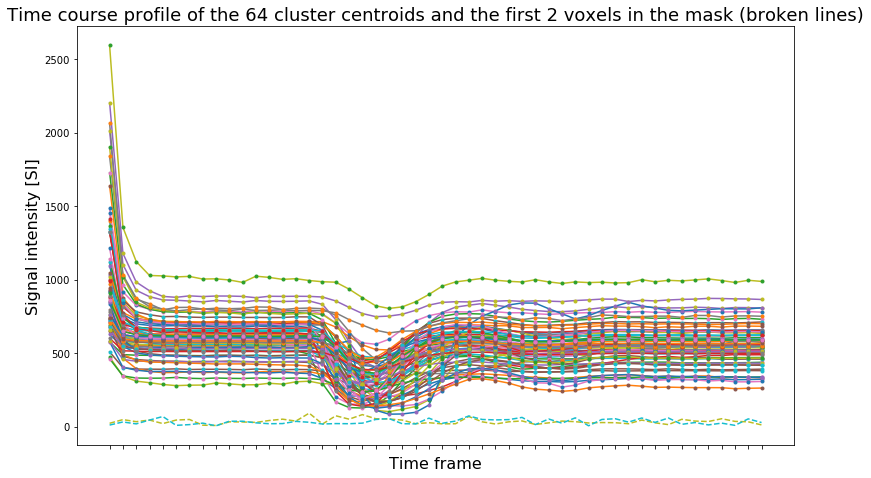

In [40]:
# Plot the cluster centroids as line plots

nv = 2

fig, ax = plt.subplots(1,1)

fig.set_size_inches(12, 7)


plt.plot(dgK.to_numpy().T)
plt.plot(dgK.to_numpy().T, '.')
plt.plot(X[:nv, :].T, '--')
plt.xlabel('Time frame', fontsize=16)
ax.set_xticks([x for x in range(X.shape[1])])
ax.set_xticklabels([], rotation='vertical', fontsize=18)
plt.ylabel('Signal intensity [SI]', fontsize=16)
#plt.xlim(0, 3)
plt.title('Time course profile of the %d cluster centroids and the first %d voxels in the mask (broken lines)' % (K, nv), fontsize=18)

plt.subplots_adjust(bottom=.12, top=.95, right=.95, left=.12)

plt.show()


### Compute a 3D mean perfusion image with respect to time (using `nilearn`)

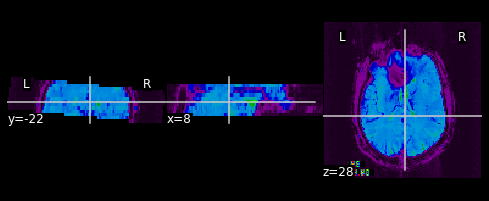

In [41]:
from nilearn.image.image import mean_img
from nilearn import plotting

# Compute the mean EPI: we do the mean along the axis 3, which is time

mean_perf = mean_img(img)

from nilearn.plotting import plot_epi, show
plot_epi(mean_perf)

display = plotting.plot_epi(mean_perf)     
display.close()

### Compute a 3D mask image derived from the 4D echo planar imaging (epi) data using `compute_epi_mask`

In [42]:
from nilearn.masking import compute_epi_mask
mask_img = compute_epi_mask(img, lower_cutoff=0.05, upper_cutoff=0.8, verbose=1)

EPI mask computation


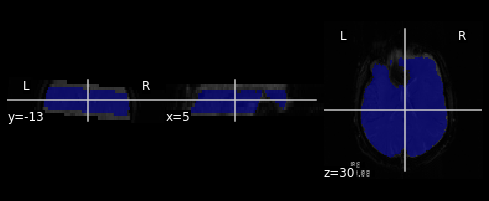

In [43]:
# Visualize it as an ROI
from nilearn.plotting import plot_roi
plot_roi(mask_img, mean_perf)
plt.show()

In [44]:
mask_img.shape

(128, 128, 11)

In [45]:
print(mask_img.get_fdata().shape)
print(mask_img.get_fdata().max())

(128, 128, 11)
1.0


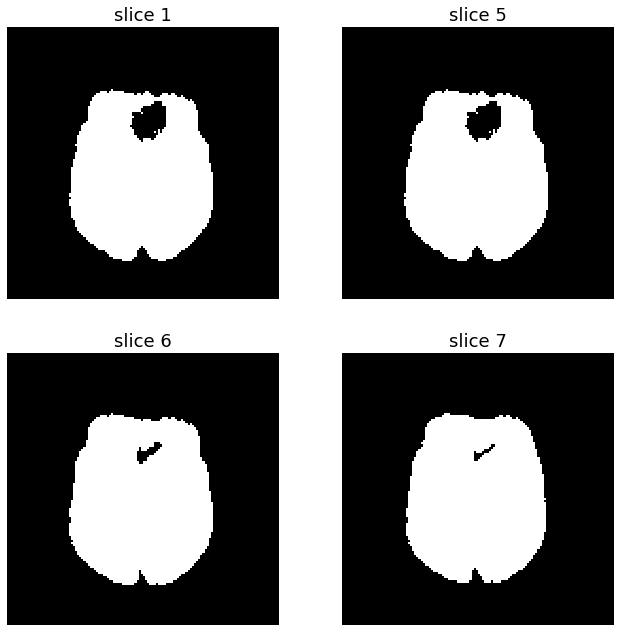

In [46]:
sl = [1, 5, 6, 7]
fig = plt.figure('Showing the DSC-MRI mask image', figsize = [11,11])
plt.tight_layout
plt.subplot(2, 2, 1).set_axis_off(), plt.title('slice %d' % (sl[0]), fontsize=18)
plt.imshow(mask_img.get_fdata()[:, :, sl[1]].T, cmap='gray', origin='lower')  
plt.subplot(2, 2, 2).set_axis_off(), plt.title('slice %d' % (sl[1]), fontsize=18)
plt.imshow(mask_img.get_fdata()[:, :, sl[1]].T, cmap='gray', origin='lower')
plt.subplot(2, 2, 3).set_axis_off(), plt.title('slice %d' % (sl[2]), fontsize=18)
plt.imshow(mask_img.get_fdata()[:, :, sl[2]].T, cmap='gray', origin='lower')
plt.subplot(2, 2, 4).set_axis_off(), plt.title('slice %d' % (sl[3]), fontsize=18)
plt.imshow(mask_img.get_fdata()[:, :, sl[3]].T, cmap='gray', origin='lower')
plt.show()

In [47]:
msk = mask_img.get_fdata()
mm = np.where(msk[:,:,:] == 1)
print('Number of voxels in the mask:', len(mm[0]))
print('i', mm[0][:5])
print('j', mm[1][:5])
print('k', mm[2][:5])

Number of voxels in the mask: 28714
i [28 28 28 28 28]
j [43 44 45 45 46]
k [2 2 2 3 2]


### Apply mask  (nilearn)

In [48]:
from nilearn.masking import apply_mask

masked_data = apply_mask(img, mask_img)
print('shape of masked data:', masked_data.shape)
print('max SI in masked data:', masked_data.max())
print('99.5 percentile of SI:', np.percentile(masked_data, 99.5))

shape of masked data: (50, 28714)
max SI in masked data: 2976.0
99.5 percentile of SI: 949.0


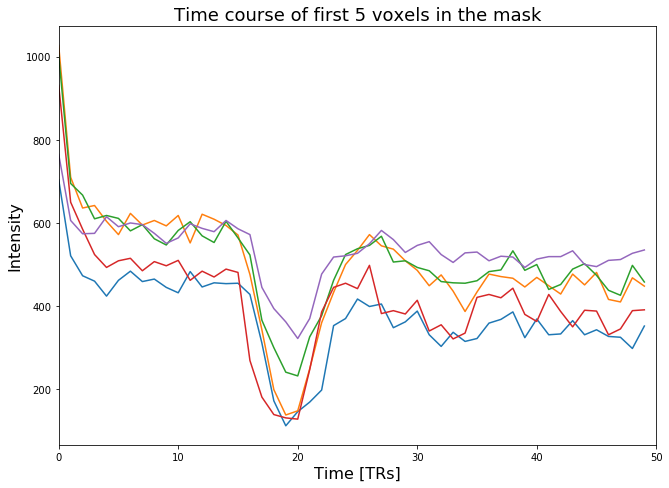

In [49]:
# masked_data shape is (timepoints, voxels). We can plot the first 50
# timepoints from nv voxels

nv = 5
# And now plot a few of these
import matplotlib.pyplot as plt
plt.figure(figsize=(10, 7))
plt.plot(masked_data[:50, :nv],'-')
plt.xlabel('Time [TRs]', fontsize=16)
plt.ylabel('Intensity', fontsize=16)
plt.xlim(0, 50)
plt.title('Time course of first %d voxels in the mask' % (nv), fontsize=18)
plt.subplots_adjust(bottom=.12, top=.95, right=.95, left=.12)

plt.show()

## K-means "smoothed" data within the ROI  (back to our `kmeans_segm2_max` mask)

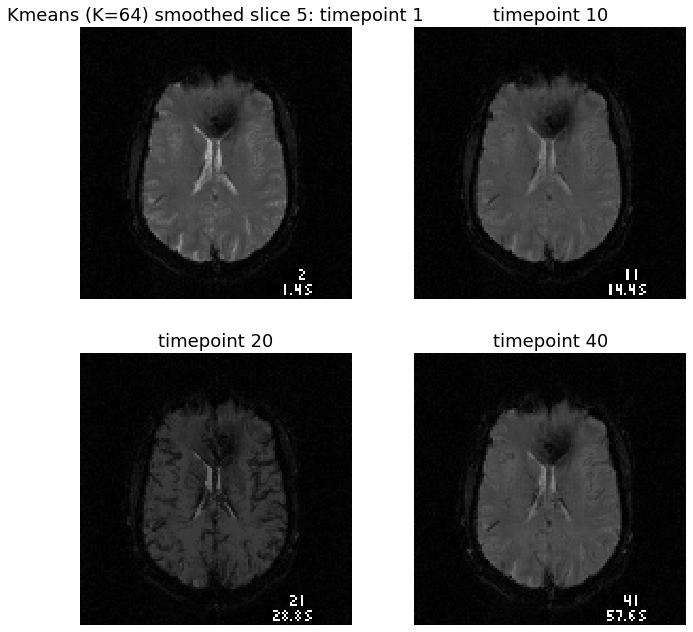

In [50]:
t = [1, 10, 20, 40]
fig = plt.figure('Showing the K-means smoothed 4D DSC-MRI data', figsize = [11,11])
plt.tight_layout
plt.subplot(2, 2, 1).set_axis_off(), plt.title('Kmeans (K=%d) smoothed slice %d: timepoint %d' % (K, s, t[0]), fontsize=18)
plt.imshow(data_smooth_K[:, :, s, t[0]].T, cmap='gray', origin='lower')  
plt.subplot(2, 2, 2).set_axis_off(), plt.title('timepoint %d' % (t[1]), fontsize=18)
plt.imshow(data_smooth_K[:, :, s, t[1]].T, cmap='gray', origin='lower')
plt.subplot(2, 2, 3).set_axis_off(), plt.title('timepoint %d' % (t[2]), fontsize=18)
plt.imshow(data_smooth_K[:, :, s, t[2]].T, cmap='gray', origin='lower')
plt.subplot(2, 2, 4).set_axis_off(), plt.title('timepoint %d' % (t[3]), fontsize=18)
plt.imshow(data_smooth_K[:, :, s, t[3]].T, cmap='gray', origin='lower')
plt.show()

**Make a new NIFTI image by passing the new smoothed data and keeping the affine and header from the original image**

In [51]:
img_smooth = nib.Nifti1Image(data_smooth_K, img.affine, img.header)
fn_smooth = './data/Arvid_Perf_20030919_smooth_%d.nii.gz' % (K)
nib.save(img_smooth, fn_smooth)

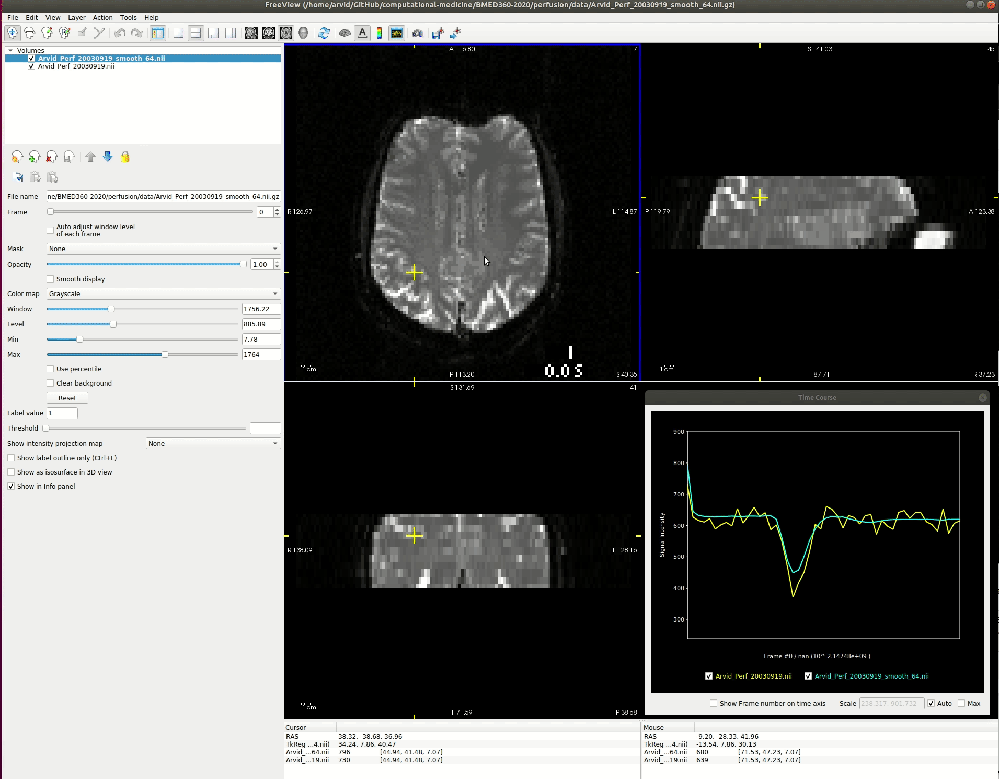

In [1]:
from IPython.display import Image
Image('./assets/perfusion_20030919_smooth_64_peek_gif.png', width=700)